# Gap Junction Connectivity Analysis
### Feb 18, 2026
### Tommy Tang
This notebook converts the output of the gj_connectivity pipeline and plots it for easier visualization of the data

In [2]:
#Libraries
import matplotlib.pyplot as plt
import numpy as np
import pickle
import pandas as pd
import seaborn as sns
import networkx as nx
from mne_connectivity.viz import plot_connectivity_circle

# Neuron-Specific

In [20]:
#Load data
with open("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_neuronal_gj_analysis_p03lmvzp.pkl", "rb") as file: 
    data = pickle.load(file)
with open("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_neuronal_gj_analysis_u4lqcs5g.pkl", "rb") as file2: 
    data2 = pickle.load(file2)
    

In [21]:
#Read neuron labels
neuron_ids = pd.read_csv("/Users/tommy/Projects/gap-junction-segmentation/neuron_ids_no_muscles.csv")
neuron_ids_adult = neuron_ids['adult']
neuron_ids_adult_zero_filtered = neuron_ids_adult[neuron_ids_adult>0]

In [22]:
#Convert to dataframe
df_p03lmvzp = pd.DataFrame(data).T
df_u4lqcs5g = pd.DataFrame(data2).T

In [23]:
#Change index in Dataframe to neurons
id_to_name = dict(zip(neuron_ids.adult, neuron_ids.name))
df_p03lmvzp.index = df_p03lmvzp.index.map(id_to_name)
df_u4lqcs5g.index = df_u4lqcs5g.index.map(id_to_name)


In [24]:
print(id_to_name[5])
print(id_to_name[19])

IL1R
IL1VR


In [ ]:
#Descriptive statistics
print(df_p03lmvzp.describe())
print(df_u4lqcs5g.describe())

        total_voxels      gj_voxels  gj_fraction
count     180.000000     180.000000   180.000000
mean   206688.127778   30776.305556     0.136442
std    117681.249585   30804.618503     0.085231
min     48893.000000     787.000000     0.005635
25%    125677.250000   11219.000000     0.075028
50%    176462.000000   20884.500000     0.117499
75%    261208.500000   35331.000000     0.178428
max    778671.000000  162605.000000     0.399743
        total_voxels      gj_voxels  gj_fraction
count     180.000000     180.000000   180.000000
mean   206688.127778   35482.905556     0.161558
std    117681.249585   27655.495429     0.061248
min     48893.000000    1070.000000     0.007662
25%    125677.250000   16220.750000     0.121274
50%    176462.000000   28396.500000     0.155677
75%    261208.500000   43881.250000     0.201047
max    778671.000000  155724.000000     0.331806


In [73]:
df_p03lmvzp

,total_voxels,gj_voxels,gj_fraction
SAADL,302340.0,37619.0,0.124426
ALNR,48893.0,7397.0,0.151290
AVDR,186339.0,7727.0,0.041467
SMBDL,260164.0,41951.0,0.161248
SDQR,143574.0,19378.0,0.134969
...,...,...,...
URAVL,94566.0,13758.0,0.145486
OLQVL,233530.0,24757.0,0.106012
IL2L,98285.0,17644.0,0.179519
ALNL,55505.0,4589.0,0.082677


/var/folders/h6/fbv263fs76l9q0vp58_tsj5c0000gn/T/ipykernel_69273/3534167323.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


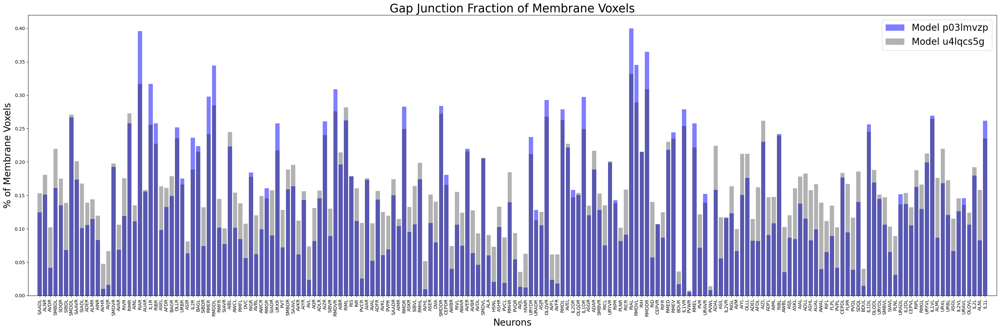

In [122]:
#Figure 1: Gap Junction Fraction of Membrane Voxels
fig, ax = plt.subplots(figsize=(30, 10))
ax.bar(df_p03lmvzp.index, df_p03lmvzp.gj_fraction, label="Model p03lmvzp", alpha=0.5, color="blue")
ax.bar(df_u4lqcs5g.index, df_u4lqcs5g.gj_fraction, label="Model u4lqcs5g", alpha=0.3, color="black")
ax.set_title("Gap Junction Fraction of Membrane Voxels", fontsize=25)
ax.set_ylabel("% of Membrane Voxels", fontsize=20)
ax.set_xlabel("Neurons", fontsize=20)
ax.legend(fontsize=20)
ax.margins(x=0.01)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 1 - Gap Junction Fraction of Membrane Voxels.png", dpi=300)

/var/folders/h6/fbv263fs76l9q0vp58_tsj5c0000gn/T/ipykernel_69273/3294055202.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


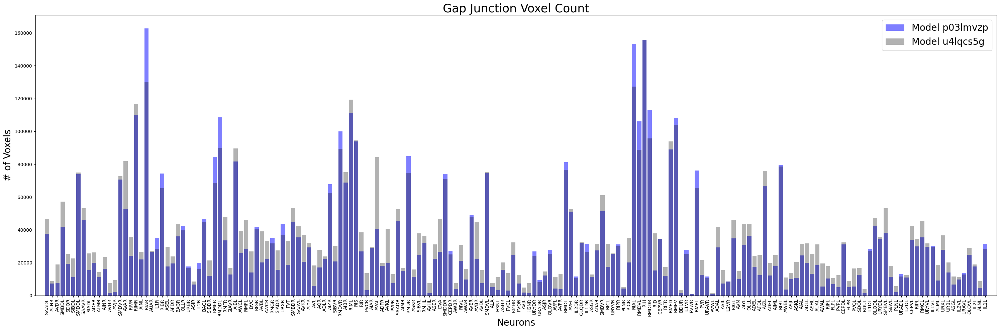

In [123]:
#Figure 2: Gap Junction Raw Voxel Count
fig, ax = plt.subplots(figsize=(30, 10))
ax.bar(df_p03lmvzp.index, df_p03lmvzp.gj_voxels, label="Model p03lmvzp", alpha=0.5, color="blue")
ax.bar(df_u4lqcs5g.index, df_u4lqcs5g.gj_voxels, label="Model u4lqcs5g", alpha=0.3, color="black")
ax.set_title("Gap Junction Voxel Count", fontsize=25)
ax.set_ylabel("# of Voxels", fontsize=20)
ax.set_xlabel("Neurons", fontsize=20)
ax.legend(fontsize=20)
ax.margins(x=0.01)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 2 - Gap Junction Voxel Count.png", dpi=300)

/var/folders/h6/fbv263fs76l9q0vp58_tsj5c0000gn/T/ipykernel_69273/1518510191.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


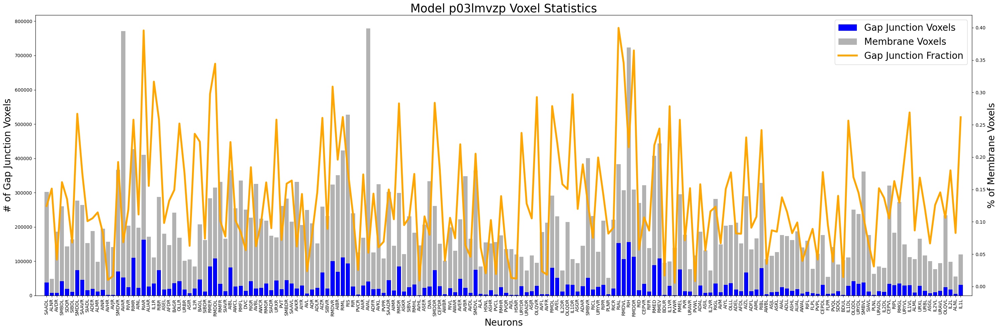

In [121]:
#Figure 3: Model p03lmvzp gj voxel count, and membrane voxel count
fig, ax = plt.subplots(figsize=(30, 10))
#Axis 1 - Voxels
ax.bar(df_p03lmvzp.index, df_p03lmvzp.gj_voxels, label="Gap Junction Voxels", color="blue", alpha=1, zorder=2)
ax.bar(df_p03lmvzp.index, df_p03lmvzp.total_voxels, label="Membrane Voxels", color="black", alpha=0.3, zorder=1)
ax.set_title("Model p03lmvzp Voxel Statistics", fontsize=25)
ax.set_ylabel("# of Gap Junction Voxels", fontsize=20)
ax.set_xlabel("Neurons", fontsize=20)
ax.margins(x=0.01)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

#Axis 2 - Gap Junction Fraction
ax2 = ax.twinx()
ax2.plot(df_p03lmvzp.index, df_p03lmvzp.gj_fraction, label="Gap Junction Fraction", color="orange", alpha=1, linewidth=4, zorder=3)
ax2.set_ylabel("% of Membrane Voxels", fontsize=20)
# Combine both legends on ax2 so they're on the same layer
lines1, labels1 = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines1 + lines2, labels1 + labels2, fontsize=20, loc="upper right").set_zorder(10)

plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 3 - Model p03lmvzp Voxel Statistics.png", dpi=300)

/var/folders/h6/fbv263fs76l9q0vp58_tsj5c0000gn/T/ipykernel_69273/64278012.py:10: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


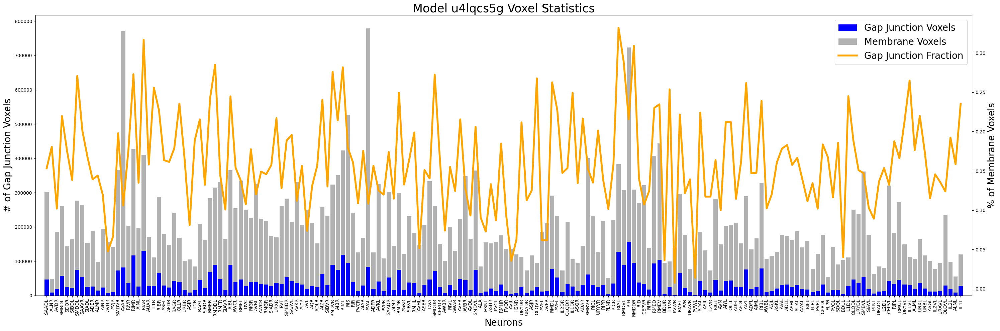

In [124]:
#Figure 4: Model u4lqcs5g gj voxel count, and membrane voxel count
fig, ax = plt.subplots(figsize=(30, 10))
#Axis 1 - Voxels
ax.bar(df_u4lqcs5g.index, df_u4lqcs5g.gj_voxels, label="Gap Junction Voxels", color="blue", alpha=1, zorder=2)
ax.bar(df_u4lqcs5g.index, df_u4lqcs5g.total_voxels, label="Membrane Voxels", color="black", alpha=0.3, zorder=1)
ax.set_title("Model u4lqcs5g Voxel Statistics", fontsize=25)
ax.set_ylabel("# of Gap Junction Voxels", fontsize=20)
ax.set_xlabel("Neurons", fontsize=20)
ax.margins(x=0.01)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

#Axis 2 - Gap Junction Fraction
ax2 = ax.twinx()
ax2.plot(df_u4lqcs5g.index, df_u4lqcs5g.gj_fraction, label="Gap Junction Fraction", color="orange", alpha=1, linewidth=4, zorder=3)
ax2.set_ylabel("% of Membrane Voxels", fontsize=20)
# Combine both legends on ax2 so they're on the same layer
lines1, labels1 = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines1 + lines2, labels1 + labels2, fontsize=20, loc="upper right").set_zorder(10)

plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 4 - Model u4lqcs5g Voxel Statistics.png", dpi=300)

# Neuron-Neuron

In [3]:
#Load dataframes from pickle
with open ("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_neuronal_gj_connectivity_p03lmvzp.pkl", 'rb') as file3:
    df_p03lmvzp_gj_connectome = pickle.load(file3)
with open ("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_contactome_p03lmvzp.pkl", 'rb') as file4:
    df_p03lmvzp_contactome = pickle.load(file4)
with open ("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_normalized_gj_connectivity_p03lmvzp.pkl", 'rb') as file5:
    df_p03lmvzp_gj_connectome_normalized = pickle.load(file5)
with open ("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_neuronal_gj_connectivity_u4lqcs5g.pkl", 'rb') as file6:
    df_u4lqcs5g_gj_connectome = pickle.load(file6)
with open ("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_contactome_u4lqcs5g.pkl", 'rb') as file7:
    df_u4lqcs5g_contactome = pickle.load(file7)
with open ("/Users/tommy/Projects/gap-junction-segmentation/membrane/SEM_adult_normalized_gj_connectivity_u4lqcs5g.pkl", 'rb') as file8:
    df_u4lqcs5g_gj_connectome_normalized = pickle.load(file8)

In [4]:
df_p03lmvzp_gj_connectome_normalized.fillna(0, inplace=True)
df_u4lqcs5g_gj_connectome_normalized.fillna(0, inplace=True)

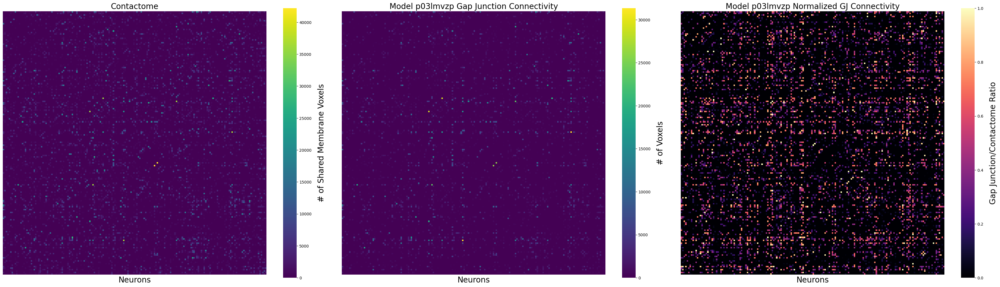

In [ ]:
# Create heatmaps for all three matrices for model p03lmvzp
fig, axes = plt.subplots(1, 3, figsize=(36, 10))

cmap = 'viridis'

sns.heatmap(df_p03lmvzp_contactome, annot=False, cmap=cmap, vmin=0, vmax=42000, xticklabels=False, yticklabels=False, square=True, ax=axes[0], cbar_kws={'label': '# of Voxels'})
axes[0].set_title('Contactome', fontsize=20)
axes[0].set_xlabel('Neurons', fontsize=20)
axes[0].collections[0].colorbar.ax.set_ylabel('# of Shared Membrane Voxels', fontsize=20, labelpad=15)
sns.heatmap(df_p03lmvzp_gj_connectome, annot=False, cmap=cmap, vmin=0, vmax=42000, xticklabels=False, yticklabels=False, square=True, ax=axes[1], cbar_kws={'label': '# of Voxels'})
axes[1].set_title('Model p03lmvzp Gap Junction Connectivity', fontsize=20)
axes[1].set_xlabel('Neurons', fontsize=20)
axes[1].collections[0].colorbar.ax.set_ylabel('# of Voxels', fontsize=20, labelpad=15)
sns.heatmap(df_p03lmvzp_gj_connectome_normalized, annot=False, cmap='magma', vmin=0, xticklabels=False, yticklabels=False, square=True, ax=axes[2])
axes[2].set_title('Model p03lmvzp Normalized GJ Connectivity', fontsize=20)
axes[2].set_xlabel('Neurons', fontsize=20)
axes[2].collections[0].colorbar.ax.set_ylabel('Gap Junction/Contactome Ratio', fontsize=20, labelpad=15)

plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 5 - Model p03lmvzp Electrical Connectivity and Contactome.png", dpi=300)

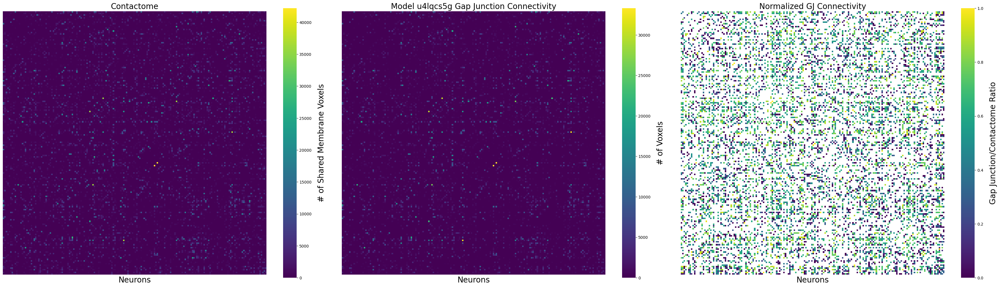

In [166]:
# Create heatmaps for all three matrices for model u4lqcs5g
fig, axes = plt.subplots(1, 3, figsize=(36, 10))

cmap = 'viridis'

sns.heatmap(df_u4lqcs5g_contactome, annot=False, cmap=cmap, vmin=0, xticklabels=False, yticklabels=False, square=True, ax=axes[0], cbar_kws={'label': '# of Voxels'})
axes[0].set_title('Contactome', fontsize=20)
axes[0].set_xlabel('Neurons', fontsize=20)
axes[0].collections[0].colorbar.ax.set_ylabel('# of Shared Membrane Voxels', fontsize=20, labelpad=15)
sns.heatmap(df_u4lqcs5g_gj_connectome, annot=False, cmap=cmap, vmin=0, xticklabels=False, yticklabels=False, square=True, ax=axes[1], cbar_kws={'label': '# of Voxels'})
axes[1].set_title('Model u4lqcs5g Gap Junction Connectivity', fontsize=20)
axes[1].set_xlabel('Neurons', fontsize=20)
axes[1].collections[0].colorbar.ax.set_ylabel('# of Voxels', fontsize=20, labelpad=15)
sns.heatmap(df_u4lqcs5g_gj_connectome_normalized, annot=False, cmap=cmap, vmin=0, xticklabels=False, yticklabels=False, square=True, ax=axes[2])
axes[2].set_title('Normalized GJ Connectivity', fontsize=20)
axes[2].set_xlabel('Neurons', fontsize=20)
axes[2].collections[0].colorbar.ax.set_ylabel('Gap Junction/Contactome Ratio', fontsize=20, labelpad=15)

plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 6 - Model u4lqcs5g Electrical Connectivity and Contactome.png", dpi=300)

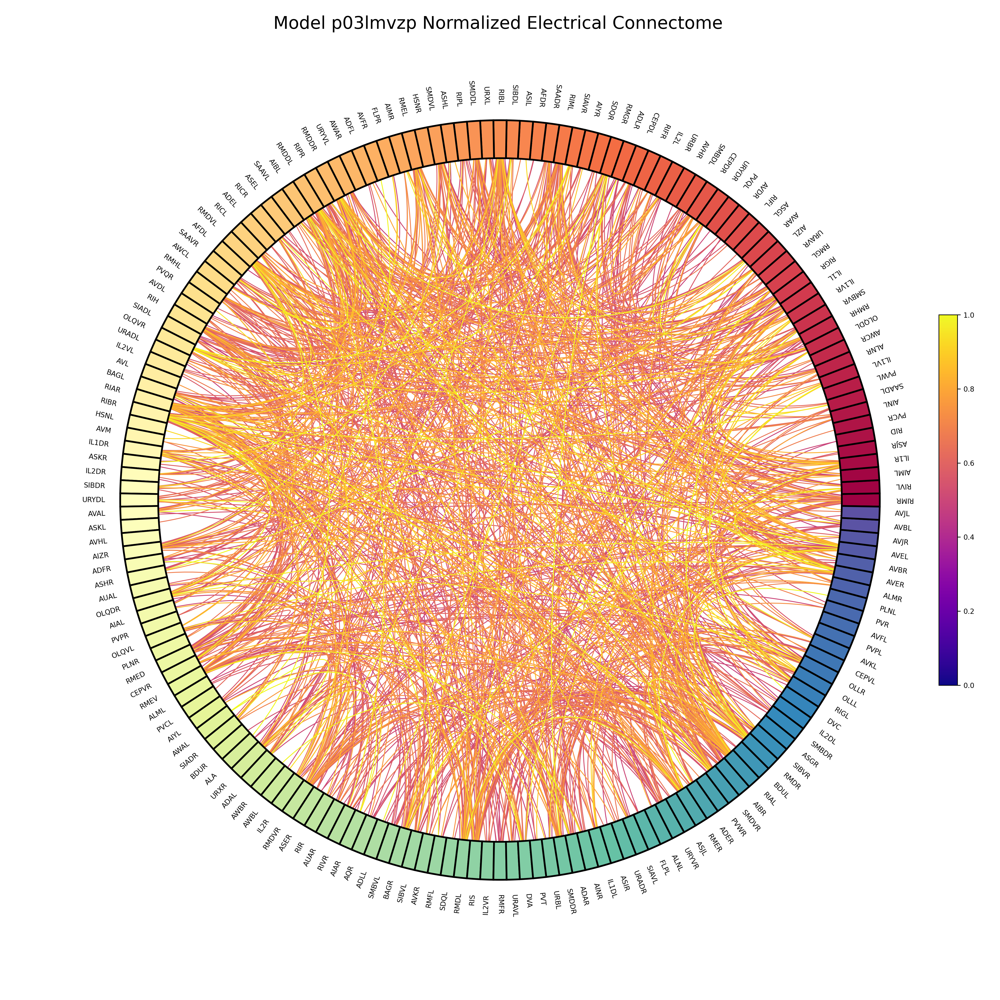

In [96]:
#%matplotlib widget
#Create circular gj connectivity plot for model p03lmvzp
#Convert to numpy
conn_matrix = df_p03lmvzp_gj_connectome_normalized.fillna(0).values

#Labels 
labels = list(df_p03lmvzp_gj_connectome_normalized.index.map(id_to_name))

fig, ax = plt.subplots(figsize=(20, 20), dpi=300, subplot_kw=dict(polar=True))

plot_connectivity_circle(
    conn_matrix, 
    labels, 
    n_lines=1000,
    fontsize_names=8,
    fontsize_title=20,
    colorbar_pos=(-0.7, 0.5),
    colorbar_size=0.3,
    colormap='plasma',
    title='',
    vmin=0,
    vmax=1,
    facecolor='white',
    textcolor='black',
    node_edgecolor='black',
    linewidth=1,
    padding=3,
    fig=fig,
    subplot=111,
    ax=ax,
    show=False
)

#x=0.5 centers it, y controls vertical position (0=bottom, 1=top)
fig.text(0.4, 0.88, 'Model p03lmvzp Normalized Electrical Connectome',
         ha='center', va='center', fontsize=20, color='black')

plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 7 - Model p03lmvzp Circular Electrical Connectome.png", dpi=300)

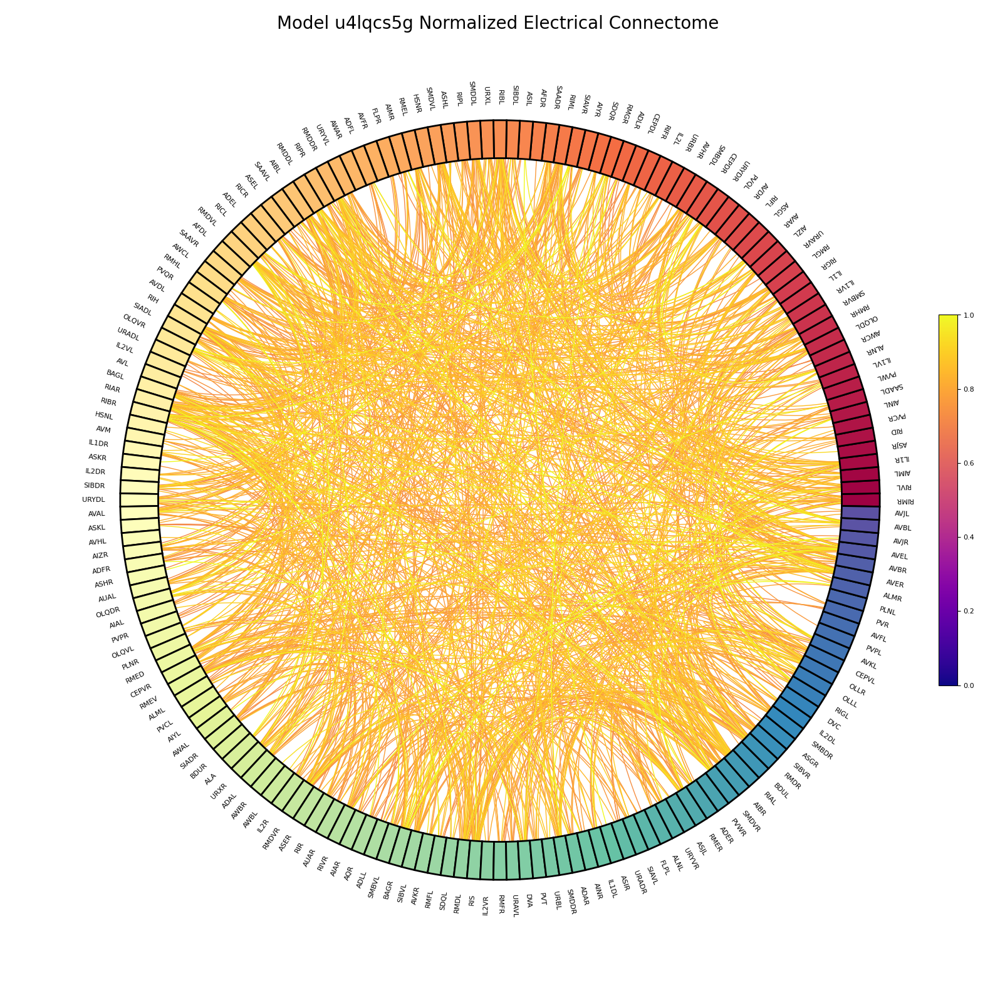

In [ ]:
#%matplotlib widget
#Create circular gj connectivity plot for model u4lqcs5g
#Convert to numpy
conn_matrix = df_u4lqcs5g_gj_connectome_normalized.fillna(0).values

#Labels 
labels = list(df_u4lqcs5g_gj_connectome_normalized.index.map(id_to_name))

fig, ax = plt.subplots(figsize=(20, 20), dpi=300, subplot_kw=dict(polar=True))

plot_connectivity_circle(
    conn_matrix, 
    labels, 
    n_lines=1000,
    fontsize_names=8,
    fontsize_title=20,
    colorbar_pos=(-0.7, 0.5),
    colorbar_size=0.3,
    colormap='plasma',
    title='',
    vmin=0,
    vmax=1,
    facecolor='white',
    textcolor='black',
    node_edgecolor='black',
    linewidth=1,
    padding=3,
    fig=fig,
    subplot=111,
    ax=ax,
    show=False
)

#x=0.5 centers it, y controls vertical position (0=bottom, 1=top)
fig.text(0.4, 0.88, 'Model u4lqcs5g Normalized Electrical Connectome',
         ha='center', va='center', fontsize=20, color='black')

plt.tight_layout()
plt.savefig("/Users/tommy/Projects/gap-junction-segmentation/Figures/Figure 8 - Model u4lqcs5g Circular Electrical Connectome.png", dpi=300)

# Validation

In [ ]:
df_p03lmvzp_gj_connectome

In [52]:
# Get all (row, col) pairs where value == 1
result = df_p03lmvzp_gj_connectome_normalized.stack()
pairs = result[result == 1].index.tolist()
print(pairs)
id_to_name[5]

[(2, 212), (5, 154), (13, 198), (18, 191), (25, 113), (26, 74), (43, 104), (43, 168), (46, 94), (68, 121), (73, 186), (74, 26), (75, 76), (76, 75), (76, 86), (77, 212), (83, 131), (86, 76), (94, 46), (94, 214), (98, 186), (100, 115), (100, 157), (104, 43), (112, 164), (113, 25), (115, 100), (121, 68), (122, 170), (128, 133), (128, 148), (131, 83), (133, 128), (148, 128), (154, 5), (157, 100), (159, 183), (164, 112), (168, 43), (170, 122), (183, 159), (184, 191), (186, 73), (186, 98), (191, 18), (191, 184), (191, 208), (198, 13), (208, 191), (212, 2), (212, 77), (214, 94)]


'IL1R'